<a href="https://colab.research.google.com/github/Dutra-Apex/heart_disease_prediction/blob/main/TumorClassification_Gabe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup


In [ ]:
!pip install segmentation-models
!pip install tensorflow ==2.1.0
!pip install keras ==2.3.1
!pip install h5py==2.10.0

In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
import segmentation_models as sm
import tensorflow as tf
import seaborn as sns
import numpy as np
import requests
import pathlib
import glob
import PIL
import os

Segmentation Models: using `keras` framework.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.getcwd()
path = '/content/drive/My Drive/CanField'
os.chdir(path)

# Organize data

In [ ]:
# Unzips file
import zipfile
with zipfile.ZipFile('data/Training_GroundTruth.zip', 'r') as zip_ref:
    zip_ref.extractall('data')

In [ ]:
src = 'data/Training_GroundTruth/'

In [ ]:
for image in os.listdir(src):
  print(image)

globules
milia_like_cysts
negative_network
pigment_network
streaks


In [ ]:
# Creates directories and move the images based on their class
import shutil

src = 'data/Training_GroundTruth/'

for image in os.listdir(src):

  if os.path.isfile(src + image):
    if 'globules' in str(image):
      shutil.move((src + image), (src + 'globules'))
    elif 'milia' in str(image):
      shutil.move((src + image), (src + 'milia_like_cysts'))
    elif 'negative' in str(image):
      shutil.move((src + image), (src + 'negative_network'))
    elif 'pigment' in str(image):
      shutil.move((src + image), (src + 'pigment_network'))
    elif 'streaks' in str(image):
      shutil.move((src + image), (src + 'streaks'))


In [ ]:
# Creates a dictionary that maps each image name to its ID numbe
def map_id_to_file(src_dir):
  id_dict = {}

  files = (file for file in sorted(os.listdir(src_dir)) 
         if os.path.isfile(os.path.join(src_dir, file)))

  for filename in files:
    id_dict[int(filename[5:12])] = str(filename)

  return id_dict

In [ ]:
src_train_input = 'data/Training_Input/'
train_input_dict = map_id_to_file(src_train_input)
print(train_input_dict)

{0: 'ISIC_0000000.jpg', 1: 'ISIC_0000001.jpg', 3: 'ISIC_0000003.jpg', 4: 'ISIC_0000004.jpg', 6: 'ISIC_0000006.jpg', 7: 'ISIC_0000007.jpg', 8: 'ISIC_0000008.jpg', 9: 'ISIC_0000009.jpg', 11: 'ISIC_0000011.jpg', 12: 'ISIC_0000012.jpg', 13: 'ISIC_0000013.jpg', 14: 'ISIC_0000014.jpg', 15: 'ISIC_0000015.jpg', 16: 'ISIC_0000016.jpg', 17: 'ISIC_0000017.jpg', 18: 'ISIC_0000018.jpg', 19: 'ISIC_0000019.jpg', 20: 'ISIC_0000020.jpg', 21: 'ISIC_0000021.jpg', 22: 'ISIC_0000022.jpg', 23: 'ISIC_0000023.jpg', 24: 'ISIC_0000024.jpg', 25: 'ISIC_0000025.jpg', 26: 'ISIC_0000026.jpg', 27: 'ISIC_0000027.jpg', 28: 'ISIC_0000028.jpg', 29: 'ISIC_0000029.jpg', 30: 'ISIC_0000030.jpg', 31: 'ISIC_0000031.jpg', 32: 'ISIC_0000032.jpg', 34: 'ISIC_0000034.jpg', 35: 'ISIC_0000035.jpg', 36: 'ISIC_0000036.jpg', 37: 'ISIC_0000037.jpg', 38: 'ISIC_0000038.jpg', 39: 'ISIC_0000039.jpg', 40: 'ISIC_0000040.jpg', 41: 'ISIC_0000041.jpg', 42: 'ISIC_0000042.jpg', 43: 'ISIC_0000043.jpg', 44: 'ISIC_0000044.jpg', 45: 'ISIC_0000045.jpg',

In [ ]:
src_ground_truth = 'data/Training_GroundTruth/'

groundtruth_dicts = []

for folder in sorted(os.listdir(src_ground_truth)):
  id_dict = map_id_to_file(str(src_ground_truth + folder))
  groundtruth_dicts.append(id_dict)

print(groundtruth_dicts)

[{150: 'ISIC_0000150_attribute_globules.png', 151: 'ISIC_0000151_attribute_globules.png', 152: 'ISIC_0000152_attribute_globules.png', 153: 'ISIC_0000153_attribute_globules.png', 154: 'ISIC_0000154_attribute_globules.png', 155: 'ISIC_0000155_attribute_globules.png', 157: 'ISIC_0000157_attribute_globules.png', 159: 'ISIC_0000159_attribute_globules.png', 160: 'ISIC_0000160_attribute_globules.png', 161: 'ISIC_0000161_attribute_globules.png', 162: 'ISIC_0000162_attribute_globules.png', 163: 'ISIC_0000163_attribute_globules.png', 164: 'ISIC_0000164_attribute_globules.png', 165: 'ISIC_0000165_attribute_globules.png', 166: 'ISIC_0000166_attribute_globules.png', 167: 'ISIC_0000167_attribute_globules.png', 169: 'ISIC_0000169_attribute_globules.png', 170: 'ISIC_0000170_attribute_globules.png', 171: 'ISIC_0000171_attribute_globules.png', 172: 'ISIC_0000172_attribute_globules.png', 173: 'ISIC_0000173_attribute_globules.png', 175: 'ISIC_0000175_attribute_globules.png', 176: 'ISIC_0000176_attribute_g

In [ ]:
for id in groundtruth_dicts[0]:
  if id in train_input_dict:
    shutil.copy(str(src_train_input + train_input_dict[id]),
                src_train_input + 'globules')

In [ ]:
for id in groundtruth_dicts[1]:
  if id in train_input_dict:
    shutil.copy(str(src_train_input + train_input_dict[id]),
                src_train_input + 'milia_like_cyst')

In [ ]:
for id in groundtruth_dicts[2]:
  if id in train_input_dict:
    shutil.copy(str(src_train_input + train_input_dict[id]),
                src_train_input + 'negative_network')

In [ ]:
for id in groundtruth_dicts[3]:
  if id in train_input_dict:
    shutil.copy(str(src_train_input + train_input_dict[id]),
                src_train_input + 'pigment_network')

In [ ]:
for id in groundtruth_dicts[4]:
  if id in train_input_dict:
    shutil.copy(str(src_train_input + train_input_dict[id]),
                src_train_input + 'streaks')

In [ ]:
print(sorted(os.listdir('data/Training_Input/globules')))

['ISIC_0000150.jpg', 'ISIC_0000151.jpg', 'ISIC_0000152.jpg', 'ISIC_0000153.jpg', 'ISIC_0000154.jpg', 'ISIC_0000155.jpg', 'ISIC_0000157.jpg', 'ISIC_0000159.jpg', 'ISIC_0000160.jpg', 'ISIC_0000161.jpg', 'ISIC_0000162.jpg', 'ISIC_0000163.jpg', 'ISIC_0000164.jpg', 'ISIC_0000165.jpg', 'ISIC_0000166.jpg', 'ISIC_0000167.jpg', 'ISIC_0000169.jpg', 'ISIC_0000170.jpg', 'ISIC_0000171.jpg', 'ISIC_0000172.jpg', 'ISIC_0000173.jpg', 'ISIC_0000175.jpg', 'ISIC_0000176.jpg', 'ISIC_0000177.jpg', 'ISIC_0000179.jpg', 'ISIC_0000181.jpg', 'ISIC_0000182.jpg', 'ISIC_0000183.jpg', 'ISIC_0000184.jpg', 'ISIC_0000185.jpg', 'ISIC_0000186.jpg', 'ISIC_0000187.jpg', 'ISIC_0000188.jpg', 'ISIC_0000189.jpg', 'ISIC_0000190.jpg', 'ISIC_0000191.jpg', 'ISIC_0000192.jpg', 'ISIC_0000193.jpg', 'ISIC_0000196.jpg', 'ISIC_0000197.jpg', 'ISIC_0000198.jpg', 'ISIC_0000199.jpg', 'ISIC_0000200.jpg', 'ISIC_0000201.jpg', 'ISIC_0000202.jpg', 'ISIC_0000203.jpg', 'ISIC_0000204.jpg', 'ISIC_0000205.jpg', 'ISIC_0000206.jpg', 'ISIC_0000207.jpg',

In [ ]:
print(sorted(os.listdir('data/Training_GroundTruth/globules')))

['ISIC_0000150_attribute_globules.png', 'ISIC_0000151_attribute_globules.png', 'ISIC_0000152_attribute_globules.png', 'ISIC_0000153_attribute_globules.png', 'ISIC_0000154_attribute_globules.png', 'ISIC_0000155_attribute_globules.png', 'ISIC_0000157_attribute_globules.png', 'ISIC_0000159_attribute_globules.png', 'ISIC_0000160_attribute_globules.png', 'ISIC_0000161_attribute_globules.png', 'ISIC_0000162_attribute_globules.png', 'ISIC_0000163_attribute_globules.png', 'ISIC_0000164_attribute_globules.png', 'ISIC_0000165_attribute_globules.png', 'ISIC_0000166_attribute_globules.png', 'ISIC_0000167_attribute_globules.png', 'ISIC_0000169_attribute_globules.png', 'ISIC_0000170_attribute_globules.png', 'ISIC_0000171_attribute_globules.png', 'ISIC_0000172_attribute_globules.png', 'ISIC_0000173_attribute_globules.png', 'ISIC_0000175_attribute_globules.png', 'ISIC_0000176_attribute_globules.png', 'ISIC_0000177_attribute_globules.png', 'ISIC_0000179_attribute_globules.png', 'ISIC_0000181_attribute_

In [ ]:
print(sorted(os.listdir('data/Training_GroundTruth/pigment_network')))

['ISIC_0000149_attribute_pigment_network.png', 'ISIC_0000150_attribute_pigment_network.png', 'ISIC_0000151_attribute_pigment_network.png', 'ISIC_0000152_attribute_pigment_network.png', 'ISIC_0000153_attribute_pigment_network.png', 'ISIC_0000154_attribute_pigment_network.png', 'ISIC_0000157_attribute_pigment_network.png', 'ISIC_0000159_attribute_pigment_network.png', 'ISIC_0000160_attribute_pigment_network.png', 'ISIC_0000161_attribute_pigment_network.png', 'ISIC_0000162_attribute_pigment_network.png', 'ISIC_0000163_attribute_pigment_network.png', 'ISIC_0000164_attribute_pigment_network.png', 'ISIC_0000165_attribute_pigment_network.png', 'ISIC_0000166_attribute_pigment_network.png', 'ISIC_0000167_attribute_pigment_network.png', 'ISIC_0000169_attribute_pigment_network.png', 'ISIC_0000170_attribute_pigment_network.png', 'ISIC_0000171_attribute_pigment_network.png', 'ISIC_0000172_attribute_pigment_network.png', 'ISIC_0000173_attribute_pigment_network.png', 'ISIC_0000175_attribute_pigment_n

# Sort categories by occurring frequency

## Demo

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import PIL
import cv2

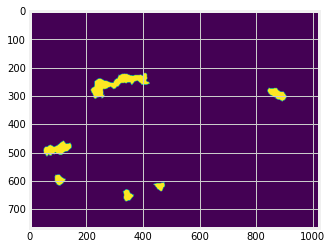

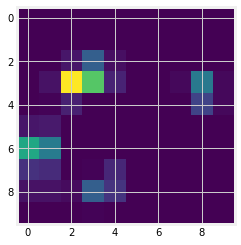

In [ ]:
src = 'data/Training_GroundTruth/'
img = PIL.Image.open(src + 'globules/ISIC_0011105_attribute_globules.png')
plt.imshow(img)
plt.show()

img = img.resize((10,10))
plt.imshow(img)
plt.show()

Resizing, although makes the code faster, might not be a good idea as there's information loss

In [ ]:
width, height = img.size
img = img.convert('L')
# iterate through each pixel in the image and count the number of white pixels
for x in range(width):
    for y in range(height):
        rgb = img.getpixel((x, y))
        print(rgb, end = " ")

0 0 0 0 0 6 59 14 5 0 0 0 0 5 1 7 41 12 5 0 0 0 6 99 9 0 0 0 3 0 0 0 30 73 0 0 0 1 30 1 0 0 4 10 0 0 0 11 15 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 40 20 0 0 0 0 0 0 0 0 2 2 0 0 0 0 0 

## Application

In [ ]:
# Given an image path, converts the image to single channel black and white
# and return the number of white pixels
def count_bw_pixels(img_path):

  img = PIL.Image.open(img_path)
  width, height = img.size
  img = img.convert('L')
  white_count = 0

  for x in range(width):
      for y in range(height):
          pixel_value = img.getpixel((x, y))
          if pixel_value >= 200:
            white_count += 1

  return white_count

In [ ]:
src = 'data/Validation_GroundTruth/'
class_dir = {'globules': src + 'globules/', 
             'milia_like_cysts' : src + 'milia_like_cysts/',
             'negative_network' : src + 'negative_network/',
             'pigment_network' : src + 'pigment_network/',
             'streaks' : src + 'streaks/'}

In [ ]:
class_dir.keys()

dict_keys(['globules', 'milia_like_cysts', 'negative_network', 'pigment_network', 'streaks'])

In [ ]:
white_count = 0
avg_white_count = 0

for dir in class_dir.values():
  for file in os.listdir(str(dir)):
    white_count += count_bw_pixels(str(dir + file))
  
  avg_white_count = white_count/len(os.listdir(dir))
  white_count = 0
  print("Average white pixel count for ", dir, " ", avg_white_count)

  

Average white pixel count for  data/Validation_GroundTruth/globules/   16830.3
Average white pixel count for  data/Validation_GroundTruth/milia_like_cysts/   6396.92
Average white pixel count for  data/Validation_GroundTruth/negative_network/   16596.7
Average white pixel count for  data/Validation_GroundTruth/pigment_network/   247496.49
Average white pixel count for  data/Validation_GroundTruth/streaks/   2673.23


# Semantic Segmentation

In [ ]:
BACKBONE = 'resnet34'
preprocess_input = sm.get_preprocessing(BACKBONE)

In [ ]:
#Sets image parameters
batch_size = 30
img_height = 224
img_width = 224
IMG_WIDTH_HEIGHT = 224

## Loading and splitting data

In [ ]:
input_dir = 'data/Training_Input/pigment_network'
target_dir = 'data/Training_GroundTruth/pigment_network'

input_img_paths = sorted(
    [
        os.path.join(input_dir, fname)
        for fname in os.listdir(input_dir)
        if fname.endswith(".jpg")
    ]
)
target_img_paths = sorted(
    [
        os.path.join(target_dir, fname)
        for fname in os.listdir(target_dir)
        if fname.endswith(".png") and not fname.startswith(".")
    ]
)

In [ ]:
print(input_img_paths)

['data/Training_Input/pigment_network/ISIC_0000149.jpg', 'data/Training_Input/pigment_network/ISIC_0000150.jpg', 'data/Training_Input/pigment_network/ISIC_0000151.jpg', 'data/Training_Input/pigment_network/ISIC_0000152.jpg', 'data/Training_Input/pigment_network/ISIC_0000153.jpg', 'data/Training_Input/pigment_network/ISIC_0000154.jpg', 'data/Training_Input/pigment_network/ISIC_0000157.jpg', 'data/Training_Input/pigment_network/ISIC_0000159.jpg', 'data/Training_Input/pigment_network/ISIC_0000160.jpg', 'data/Training_Input/pigment_network/ISIC_0000161.jpg', 'data/Training_Input/pigment_network/ISIC_0000162.jpg', 'data/Training_Input/pigment_network/ISIC_0000163.jpg', 'data/Training_Input/pigment_network/ISIC_0000164.jpg', 'data/Training_Input/pigment_network/ISIC_0000165.jpg', 'data/Training_Input/pigment_network/ISIC_0000166.jpg', 'data/Training_Input/pigment_network/ISIC_0000167.jpg', 'data/Training_Input/pigment_network/ISIC_0000169.jpg', 'data/Training_Input/pigment_network/ISIC_00001

In [ ]:
print(target_img_paths)

['data/Training_GroundTruth/pigment_network/ISIC_0000149_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000150_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000151_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000152_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000153_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000154_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000157_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000159_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000160_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000161_attribute_pigment_network.png', 'data/Training_GroundTruth/pigment_network/ISIC_0000162_attribute_pigment_network.png', 'data/Training_GroundTruth/pigm

In [ ]:
from keras.preprocessing.image import load_img, array_to_img, img_to_array

In [ ]:
X = np.zeros((len(input_img_paths), IMG_WIDTH_HEIGHT, IMG_WIDTH_HEIGHT, 3), dtype=np.float32)
Y = np.zeros((len(input_img_paths), IMG_WIDTH_HEIGHT, IMG_WIDTH_HEIGHT, 1), dtype=np.uint8)
for i in range(len(target_img_paths)):
    img_path = input_img_paths[i]
    img = load_img(img_path, color_mode='rgb',target_size=(IMG_WIDTH_HEIGHT, IMG_WIDTH_HEIGHT)) #imread(img_path)[:,:,:3] #.astype("float32") #/ 255.0 -> is done by rgb2gray
    img = img_to_array(img)
    X[i] = img.astype('float32') / 255.0
    
    mask_path = target_img_paths[i]
    mask = load_img(mask_path, color_mode = 'grayscale',target_size=(IMG_WIDTH_HEIGHT, IMG_WIDTH_HEIGHT))
    mask = img_to_array(mask).astype("float32")
    Y[i] = mask

In [ ]:
train_test_split = int(len(input_img_paths)*0.9)
x_train = X[:train_test_split]
y_train = Y[:train_test_split]
x_test = X[train_test_split:]
y_test = Y[train_test_split:]

82


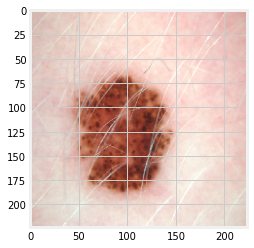

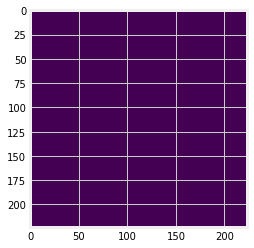

In [ ]:
import random
i = random.randint(0, len(x_test))
print(i)
plt.imshow(np.squeeze(x_test[i]))
plt.show()
plt.imshow(np.squeeze(y_test[i]))
plt.show()

644


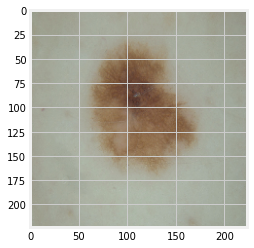

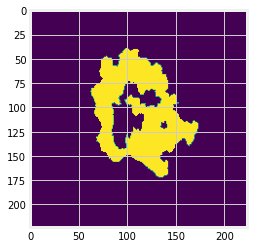

In [ ]:
import random
i = random.randint(0, len(x_train))
print(i)
plt.imshow(x_train[i])
plt.show()
plt.imshow(np.squeeze(y_train[i]))
plt.show()

In [ ]:
y_train = tf.cast(y_train, tf.float32)
y_test = tf.cast(y_test, tf.float32)

In [ ]:
x_train = preprocess_input(x_train)
x_test = preprocess_input(x_test)
y_train = preprocess_input(y_train)
y_test = preprocess_input(y_test)

## Creates and trains model


In [ ]:
sm.set_framework('tf.keras')
sm.framework()

'tf.keras'

In [ ]:
tf.keras.backend.clear_session()

In [ ]:
# define model
model = []
model = sm.Unet(backbone_name='inceptionv3')
#model.compile(optimizer='adam', loss=sm.losses.bce_jaccard_loss, metrics=[sm.metrics.iou_score])

#print(model.summary())

87924736/87910968 [==============================] - 7s 0us/step


In [ ]:
RSM = tf.keras.optimizers.RMSprop(
                            learning_rate=0.0000001,
                            rho=0.9,
                            momentum=0.0,
                            epsilon=1e-07,
                            centered=False,
                            name="RMSprop")

#sig_crossentropy = tf.nn.sigmoid_cross_entropy_with_logits(
#    labels=y_train, logits=x_train, name="sigmoid_cross_entropy")

model.compile(loss=sm.losses.bce_jaccard_loss,
               optimizer = RSM,
              metrics=[sm.metrics.iou_score])

In [ ]:
callbacks = tf.keras.callbacks.EarlyStopping(monitor='val_iou_score', 
                                min_delta=0, 
                                patience=5, 
                                verbose=2, 
                                mode='auto', 
                                baseline=None, 
                                restore_best_weights=True)

In [ ]:
history=model.fit(x_train, 
          y_train,
          batch_size=2, 
          epochs=50,
          verbose=1,
          callbacks = callbacks,
          validation_data=(x_test, y_test))

Epoch 1/50
379/379 [==============================] - 50s 92ms/step - loss: -5.3957 - iou_score: 1.0288 - val_loss: -3.3878 - val_iou_score: 0.8681
Epoch 2/50
379/379 [==============================] - 32s 84ms/step - loss: -5.9911 - iou_score: 1.0727 - val_loss: -4.6714 - val_iou_score: 0.9495
Epoch 3/50
379/379 [==============================] - 32s 84ms/step - loss: -6.7776 - iou_score: 1.1022 - val_loss: -4.9888 - val_iou_score: 0.9764
Epoch 4/50
379/379 [==============================] - 32s 85ms/step - loss: -7.5651 - iou_score: 1.1775 - val_loss: -5.5331 - val_iou_score: 1.0131
Epoch 5/50
379/379 [==============================] - 32s 83ms/step - loss: -8.4428 - iou_score: 1.2221 - val_loss: -5.8706 - val_iou_score: 1.0472
Epoch 6/50
379/379 [==============================] - 32s 84ms/step - loss: -9.2282 - iou_score: 1.2969 - val_loss: -6.0319 - val_iou_score: 1.0553
Epoch 6: early stopping


In [ ]:
model.save('Unet_resnet34.h5')

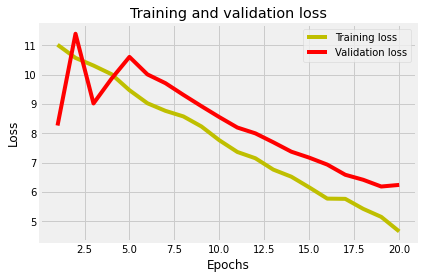

In [ ]:
#accuracy = model.evaluate(x_val, y_val)
#plot the training and validation accuracy and loss at each epoch
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
predictions = model.predict(x_test)

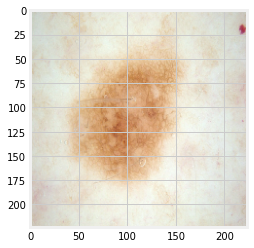

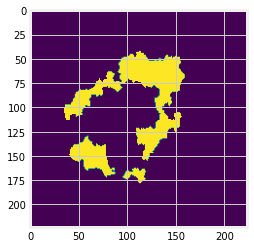

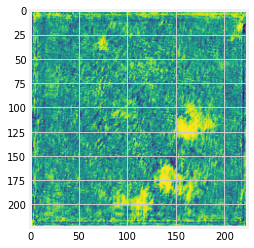

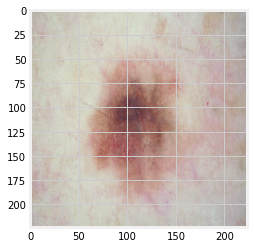

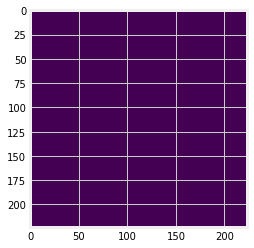

...

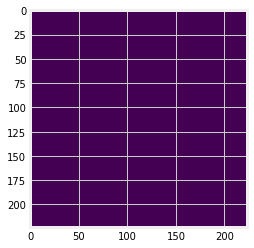

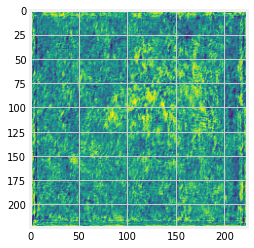

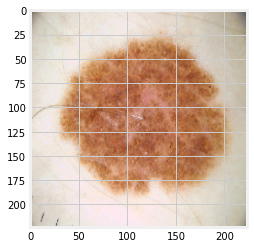

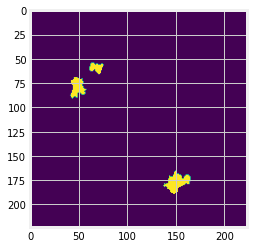

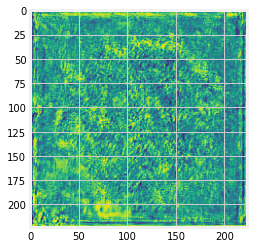

In [ ]:
for i in range(20):
  plt.imshow(x_test[i])
  plt.show()
  plt.imshow(np.squeeze(y_test[i]))
  plt.show()
  plt.imshow(np.squeeze(predictions[i]))
  plt.show()

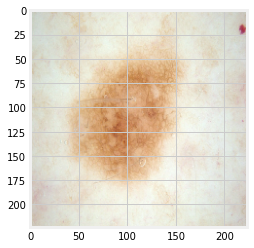

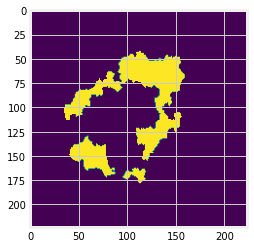

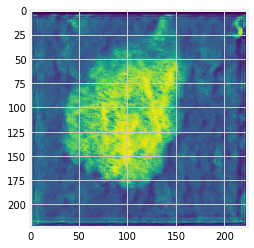

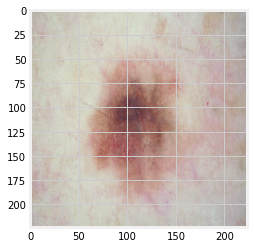

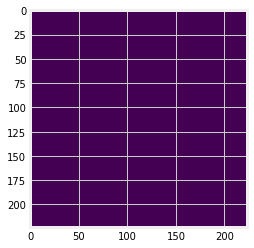

...

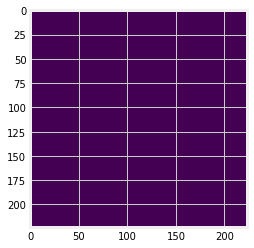

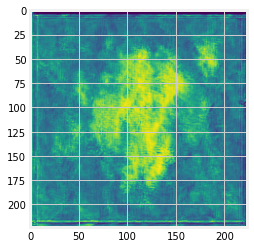

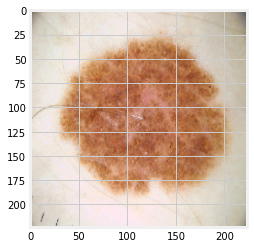

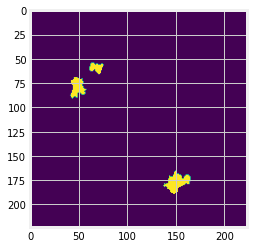

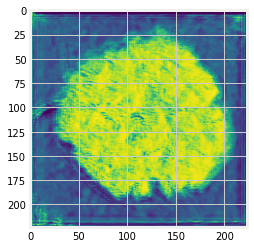

In [ ]:
for i in range(20):
  plt.imshow(x_test[i])
  plt.show()
  plt.imshow(np.squeeze(y_test[i]))
  plt.show()
  plt.imshow(np.squeeze(predictions[i]))
  plt.show()

### Jaccard loss: -12.78, IOU score 1.49, lr = 0.0000001, batch size = 1

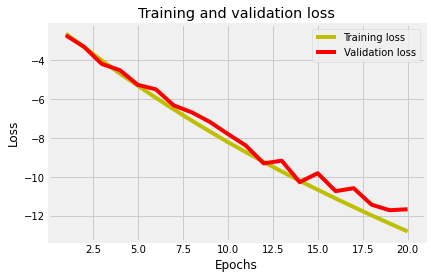

In [ ]:
#accuracy = model.evaluate(x_val, y_val)
#plot the training and validation accuracy and loss at each epoch
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
predictions = model.predict(x_test)

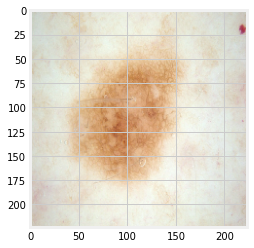

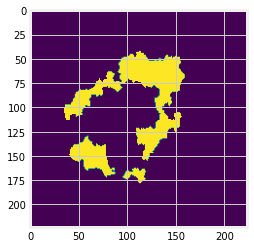

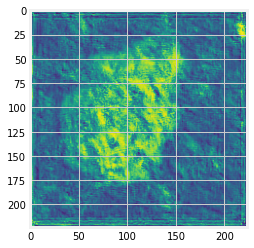

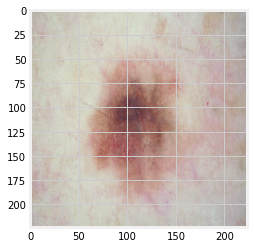

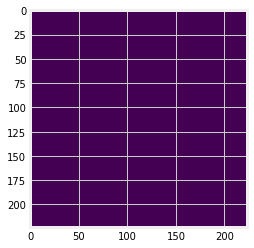

...

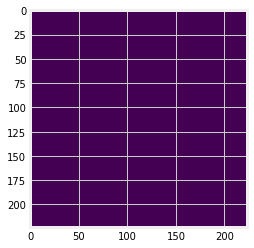

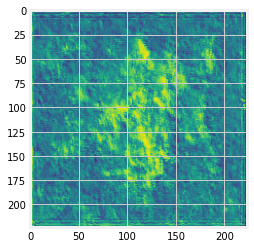

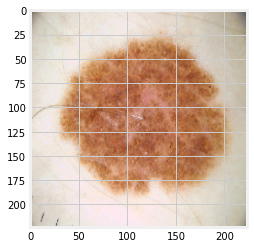

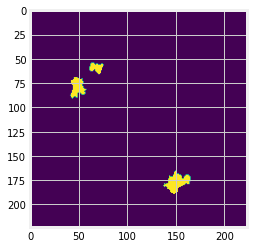

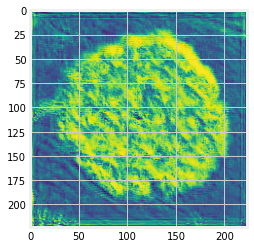

In [ ]:
for i in range(20):
  plt.imshow(x_test[i])
  plt.show()
  plt.imshow(np.squeeze(y_test[i]))
  plt.show()
  plt.imshow(np.squeeze(predictions[i]))
  plt.show()

### Jaccard loss = - 0.52, lr = 0.000000001, batch size = 1

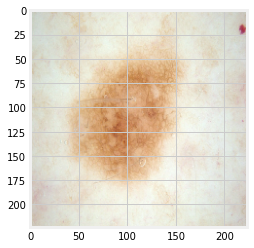

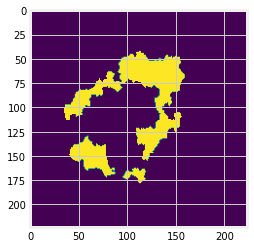

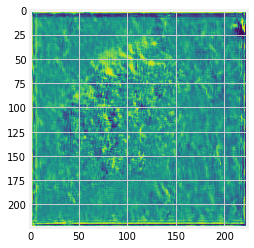

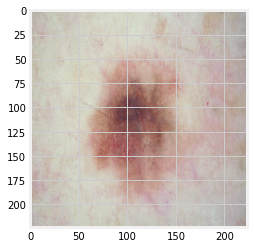

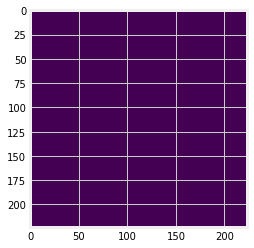

...

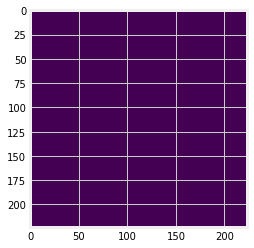

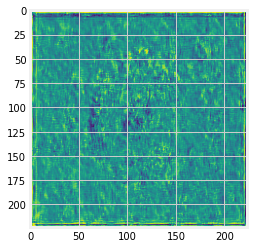

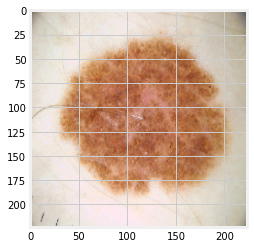

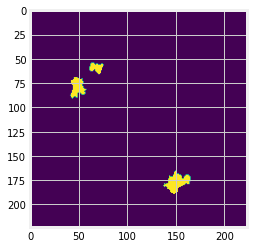

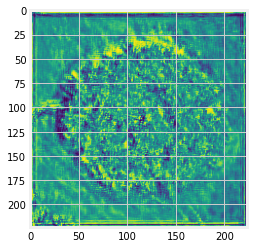

In [ ]:
for i in range(20):
  plt.imshow(x_test[i])
  plt.show()
  plt.imshow(np.squeeze(y_test[i]))
  plt.show()
  plt.imshow(np.squeeze(predictions[i]))
  plt.show()

## Evaluate convolutions

In [ ]:
model = tf.keras.models.load_model('Unet_iou_149.h5', compile = False)

In [ ]:
RSM = tf.keras.optimizers.RMSprop(
                            learning_rate=0.000005,
                            rho=0.9,
                            momentum=0.0,
                            epsilon=1e-07,
                            centered=False,
                            name="RMSprop")

model.compile(loss=sm.losses.bce_jaccard_loss,
               optimizer = RSM,
              metrics=[sm.metrics.iou_score])

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 block1_conv1 (Conv2D)          (None, None, None,   1792        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 block1_conv2 (Conv2D)          (None, None, None,   36928       ['block1_conv1[0][0]']           
                                64)                                                           

In [ ]:
FIRST_IMAGE=0
SECOND_IMAGE=7
THIRD_IMAGE=5

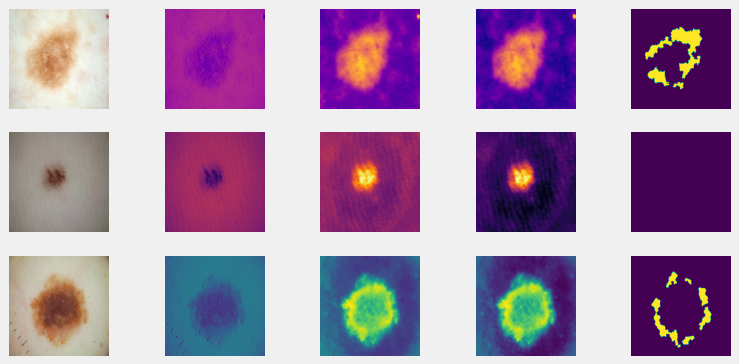

In [ ]:
#Let's vizualize what the CNN is doing with the images
f, axarr = plt.subplots(3,5, figsize=(12,6))

#Shows what each conv is doing
CONVOLUTION_NUMBER = 2

from tensorflow.keras import models
layer_outputs = [layer.output for layer in model.layers]
activation_model = tf.keras.models.Model(inputs = model.input, outputs = layer_outputs)
for x in range(1,4):
  f1 = activation_model.predict(x_test[FIRST_IMAGE].reshape(1, 224, 224, 3))[x]
  axarr[0,x].imshow(f1[0, : , :, CONVOLUTION_NUMBER], cmap='plasma')
  f2 = activation_model.predict(x_test[SECOND_IMAGE].reshape(1, 224, 224, 3))[x]
  axarr[1,x].imshow(f2[0, : , :, CONVOLUTION_NUMBER], cmap='inferno')
  f3 = activation_model.predict(x_test[THIRD_IMAGE].reshape(1, 224, 224, 3))[x]
  axarr[2,x].imshow(f3[0, : , :, CONVOLUTION_NUMBER], cmap='viridis')

axarr[0,0].imshow(x_test[FIRST_IMAGE])
axarr[1,0].imshow(x_test[SECOND_IMAGE])
axarr[2,0].imshow(x_test[THIRD_IMAGE])


axarr[0,4].imshow(np.squeeze(y_test[FIRST_IMAGE]))
axarr[1,4].imshow(np.squeeze(y_test[SECOND_IMAGE]))
axarr[2,4].imshow(np.squeeze(y_test[THIRD_IMAGE]))


for i in range(0, 3):
  for j in range(0, 5):
    axarr[i, j].grid(False)
    axarr[i ,j].axes.get_yaxis().set_visible(False)
    axarr[i ,j].axes.get_xaxis().set_visible(False)

plt.show()

## Predict given image

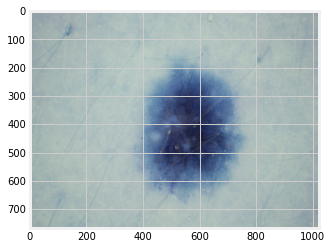

In [ ]:
img = cv2.imread('data/Validation_Input/ISIC_0012585.jpg')
plt.imshow(img)
plt.show()

In [ ]:
img_array = cv2.imread('data/Validation_Input/ISIC_0012585.jpg')
new_array = cv2.resize(img_array, (img_height, img_width))
final_img = new_array.reshape(-1, 224, 224, 3)
prediction = model.predict([final_img])
print(prediction)

[[[[1.]
   [1.]
   [1.]
   ...
   [1.]
   [1.]
   [1.]]

  [[1.]
   [1.]
   [1.]
   ...
   [1.]
   [1.]
   [1.]]

  [[1.]
   [1.]
   [1.]
   ...
   [1.]
   [1.]
   [1.]]

  ...

  [[1.]
   [1.]
   [1.]
   ...
   [1.]
   [1.]
   [1.]]

  [[1.]
   [1.]
   [1.]
   ...
   [1.]
   [1.]
   [1.]]

  [[1.]
   [1.]
   [1.]
   ...
   [1.]
   [1.]
   [1.]]]]


In [ ]:
count_zeros = 0
for i in prediction:
  for j in i:
    if j[0] == 0:
      count_zeros += 1
  
print(count_zeros)

0


In [ ]:
print(prediction.shape)

(1, 160, 160, 1)


In [ ]:
from PIL import Image

data = np.reshape(prediction, (160, 160))
img = Image.fromarray(data, '1')
img.save('test2.png')
img.show()